In [ ]:
#Librerías requeridas
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d.axes3d import Axes3D, get_test_data
from matplotlib import cm
from matplotlib import animation
from IPython.display import HTML
import math 
%matplotlib inline

## A. Ecuación de Advección lineal 1D
La ecuación de advección lineal en una dimensión es
\begin{equation}
  \frac{\partial \psi}{\partial t} +  \nu \frac{\partial \psi}{\partial x} =0,
\end{equation}
donde la velocidad de advección, v, es una constante. Solucione numéricamente esta ecuación utilizando un perfil inicial sinusoidal
\begin{equation}
  \Psi_0 = \psi\left( x, t = 0\right) =\sin{\left(\frac{4\pi x}{L}\right)},
\end{equation}
donde $L = 100$ con una velocidad positiva v = 0.1 en el dominio espacial $x ∈ [0, 100]$ y para un
intervalo temporal con $t ∈ [0, 1000]$. Utilice condiciones de frontera periódicas y los métodos FTCS y
Lax-Wendroff.

la condición de convergencia alpha es 1.0


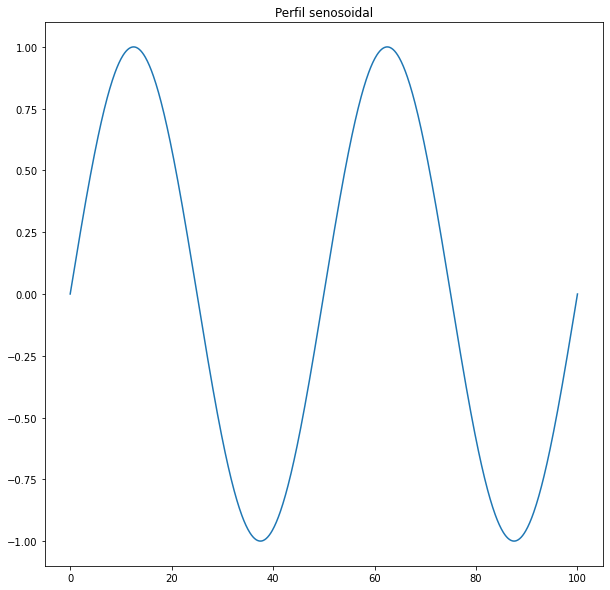

In [ ]:
##Perfil inicial
def sinp(X):
  L   = np.abs(X[-1]-X[0])
  Psi = np.sin((4*np.pi*x)/(L)) 
  return Psi
##Condiciones para el problema
x = np.linspace(0,100,1000)
t = np.linspace(0,1000,1000,dtype=int)
v = 0.1
L = np.abs(x[-1]-x[0])

dx = (x[-1]-x[0])/len(x)
dt = (t[-1]-t[0])/len(t)
alpha = (v*dt)/(dx)

print(f'la condición de convergencia alpha es',alpha)
plt.figure(figsize=(10,10))
plt.title('Perfil senosoidal')
plt.plot(x,sinp(x))

In [ ]:
#Metodo FTCS
def FTCS(Psi, x, t):

  psi = np.zeros([len(t), len(x)])
  psi[0] = Psi(x) 
    
  dt = (t[-1] - t[0])/len(t)
  dx = (x[-1] - x[0])/len(x)
    
  for n in range(len(t)-1):
    for i in range(1,len(x)-1):
      psi[n+1,i] = psi[n,i] - ((v*dt)/(2*dx))*(psi[n,i+1] - psi[n,i-1])
    else:   
      psi[n+1,0] = psi[n+1,-2]
      psi[n+1,-1] = psi[n+1,-2]
  return psi

#Metodo Lax-Wandroff
def Lax_Wendroff(Psi, x, t):

  psi = np.zeros([len(t), len(x)])
  psi[0] = Psi(x) 
    
  dt = (t[-1] - t[0])/len(t)
  dx = (x[-1] - x[0])/len(x)

  for n in range(len(t)-1):
    for i in range(1,len(x)-1):
      psi[n+1,i] = psi[n,i] - ((v*dt)/(2*dx))*(psi[n,i+1] - psi[n,i-1]) + (((v*dt)/(np.sqrt(2)*dx))**2)*(psi[n,i-1] - 2*psi[n,i] + psi[n,i+1])
    else: 
      psi[n+1,0] = psi[n+1,-2]
      psi[n+1,-1] = psi[n+1,-2]
  return psi


In [ ]:
#Resolución de la ecuación de advección por el método FTCS
psiFTCS = FTCS(sinp,x,t)

In [ ]:
#Resolución de la ecuación de advección por el método Lax-Wandroff
psiLW = Lax_Wendroff(sinp,x,t)

---
## Animación del método FTCS

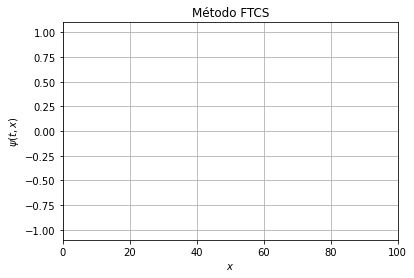

In [ ]:
fig, ax = plt.subplots()
plt.title('Método FTCS')
ax.set_xlim(( 0, 100))
ax.set_ylim((-1.1, 1.1))
ax.set_xlabel(r'$x$')
ax.set_ylabel(r'$\psi(t,x)$')
plt.grid()

line, = ax.plot([], [], lw=2)


def init():
    line.set_data([], [])
    return (line,)

def animateFTCS(i):
    X = x 
    y = psiFTCS[int(1000/200)*i,:] 
    line.set_data(X, y)
    return (line,)

anim1 = animation.FuncAnimation(fig, animateFTCS, init_func=init,
                               frames=200, interval=20,  
                               blit=True)

In [ ]:
HTML(anim1.to_jshtml())

---
## Animación del método Lax-Wendroff

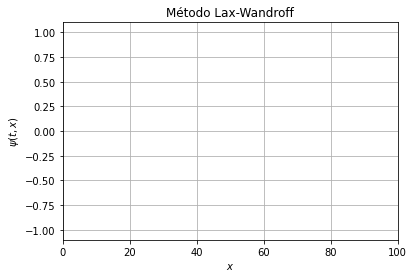

In [ ]:
fig, ax = plt.subplots()
plt.title('Método Lax-Wandroff')
ax.set_xlim(( 0, 100))
ax.set_ylim((-1.1, 1.1))
ax.set_xlabel(r'$x$')
ax.set_ylabel(r'$\psi(t,x)$')
plt.grid()

line, = ax.plot([], [], lw=2)

def animateLW(i):
    X = x 
    y = psiLW[int(1000/200)*i,:] 
    line.set_data(X, y)
    return (line,)

anim2 = animation.FuncAnimation(fig, animateLW, init_func=init,
                               frames=200, interval=20,  
                               blit=True)

In [ ]:
HTML(anim2.to_jshtml())

---
## B. Ecuación dee Burguer
La ecuación de Burguer es
\begin{equation}
  \frac{\partial \psi}{\partial t} + \psi \frac{\partial \psi}{\partial x} = 0
\end{equation}
y es utilizada como un primer ejemplo de las consecuencias de la no-linealidad en la hidrodinámica. Es muy similar a la ecuación de advección, pero en este caso la velocidad NO es una constante sino que es el mismo campo ψ que se quiere encontrar. Esta característica puede llevar a efectos como los shocks o la rarefacción, que son típicos en las descripciones de la hidrodinámica.
1. Solucione la ecuación de Burger para evolucionar un perfil sinusoidal,
\begin{equation}
  \Psi_0 = \psi \left(x, t=0\right) = \frac{1}{8}\sin \left(\frac{2 \pi x}{L}\right)
\end{equation}
en el dominio $[0, L]$ con $L = 100$.
Utilice condiciones de frontera de “outflow” (recuerde que bajo esta condición los datos de los últimos puntos interiores en la malla son copiados en los puntos de frontera.) y muestre que la solución forma un shock después de $t ≳ 140$.
2. Solucione la ecuación de Burger para evolucionar un perfíl de paso,
\begin{equation}
  \Phi_0=\Phi\left(x,t=0\right)=\left\{ \begin{array}{lcc}
             1 &   si  & x < 0.5 \\ 
             2 &   si  & x > 0.5\end{array}
   \right.
\end{equation} 
en el dominio $[0, 1]$ para mostrar la aparición de la rarefacción.

---
1. Para el método Lax-Wendroff tenemos que la solución de la ecuación de advección es
\begin{equation}
\psi_j^{(n+1)} = \psi_j^n - \frac{v\Delta t}{2\Delta x} \left(\psi_{j+1}^{(n)}
- \psi_{j-1}^{(n)} \right) + \frac{v^2(\Delta t)^2}{2(\Delta x)^2} \left(
\psi_{j-1}^{(n)} - 2 \psi_j^{(n)} + \psi_{j+1}^{(n)}\right),\
\end{equation}
tal que para la ecuación de Burguer es suficiente con cambiar la velocidad por la función, por lo cual
\begin{equation}
\psi_j^{(n+1)} = \psi_j^n - \frac{\Delta t}{2\Delta x} \psi_j^n \left(\psi_{j+1}^{(n)}
- \psi_{j-1}^{(n)} \right) + \frac{(\Delta t)^2}{2(\Delta x)^2} \left(\psi_j^n\right)^2 \left(
\psi_{j-1}^{(n)} - 2 \psi_j^{(n)} + \psi_{j+1}^{(n)}\right)\,\,.
\end{equation}


la condición de convergencia alpha es 0.1 0.15


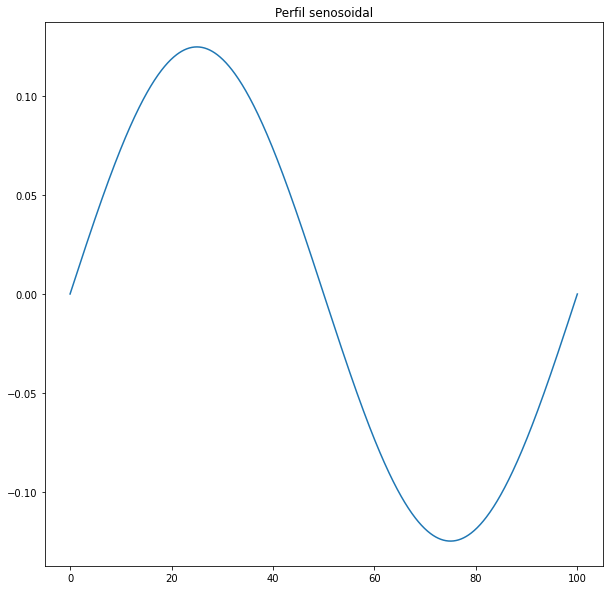

In [ ]:
#Definición del metodo de integración
def LaxWendroffBurguer(Psi, x, t):

  psi = np.zeros([len(t), len(x)])
  psi[0] = Psi(x) 
    
  dt = (t[-1] - t[0])/len(t)
  dx = (x[-1] - x[0])/len(x)

  for n in range(len(t)-1):
    for i in range(1,len(x)-1):
      psi[n+1,i] = psi[n,i] - psi[n,i]*((dt)/(2*dx))*(psi[n,i+1] - psi[n,i-1]) + (psi[n,i]**2)*(((dt)/(np.sqrt(2)*dx))**2)*(psi[n,i-1] - 2*psi[n,i] + psi[n,i+1])
    else: 
      psi[n+1,0] = psi[n+1,1]
      psi[n+1,-1] = psi[n+1,-2]
  return psi

##Perfil inicial
def sinbu(X):
  L   = np.abs(X[-1]-X[0])
  Psi = np.sin((2*np.pi*X)/(L))/8
  return Psi
##Condiciones para el problema
xb = np.linspace(0,100,1000)
tb = np.linspace(0,150,1000,dtype=int)
Lb = np.abs(xb[-1]-xb[0])

dxb = (xb[-1]-xb[0])/len(xb)
dtb = (tb[-1]-tb[0])/len(tb)
#Plot del perffil inicial
print(f'la condición de convergencia alpha es', dxb, dtb)
plt.figure(figsize=(10,10))
plt.title('Perfil senosoidal')
plt.plot(xb,sinbu(xb))

In [ ]:
#Resolución de la ecuación diferencial
psiLWB = LaxWendroffBurguer(sinbu,xb,tb)

### Animación 

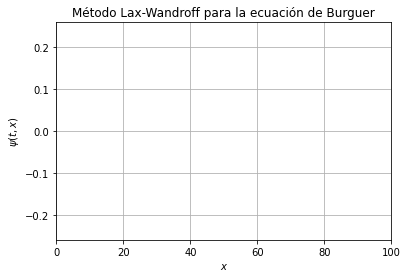

In [ ]:
fig, ax = plt.subplots()
plt.title('Método Lax-Wandroff para la ecuación de Burguer')
ax.set_xlim(( 0, 100))
ax.set_ylim((-0.26, 0.26))
ax.set_xlabel(r'$x$')
ax.set_ylabel(r'$\psi(t,x)$')
plt.grid()

line, = ax.plot([], [], lw=2)


def init():
    line.set_data([], [])
    return (line,)

def animateLWB(i):
    X = xb
    y = psiLWB[int(1000/200)*i,:] 
    line.set_data(X, y)
    return (line,)

anim3 = animation.FuncAnimation(fig, animateLWB, init_func=init,
                               frames=200, interval=20,  
                               blit=True)

In [ ]:
HTML(anim3.to_jshtml())

---
2. Podemos aplicar el mismo metodo de la sección (1) a un perfil inicial distinto

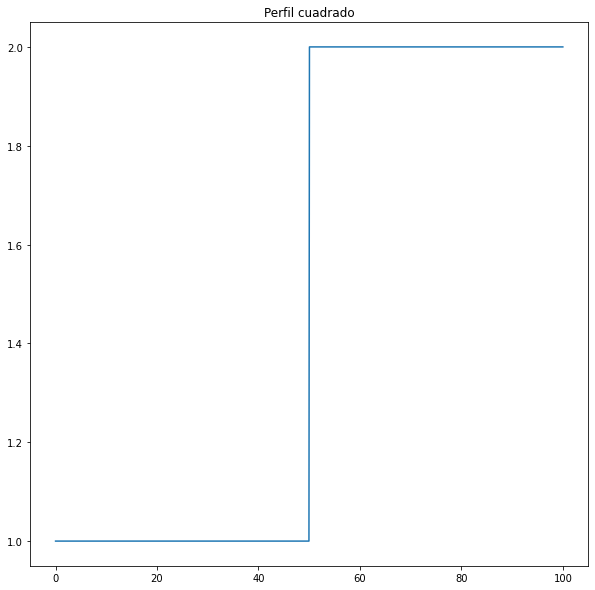

In [ ]:
def cuadrito(X):
  cua = np.zeros(len(X))
  for i in range(0,len(X)):
    if X[i] <= 50:
      cua[i] = 1
    else: 
      cua[i] = 2
  return cua

##Condiciones para el problema
xcua = np.linspace(0,100,1000)
tcua = np.linspace(0,10,1000,dtype=int)
Cuadrito = cuadrito(xcua)

#Plot del perffil inicial
plt.figure(figsize=(10,10))
plt.title('Perfil cuadrado')
plt.plot(xcua,Cuadrito)

In [ ]:
#Solución de la ecuación diferencial
psiLWBcua = LaxWendroffBurguer(cuadrito,xcua,tcua)

### Animación

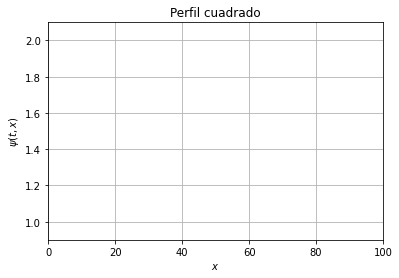

In [ ]:
fig, ax = plt.subplots()
plt.title('Perfil cuadrado')
ax.set_xlim(( 0, 100))
ax.set_ylim((0.9, 2.1))
ax.set_xlabel(r'$x$')
ax.set_ylabel(r'$\psi(t,x)$')
plt.grid()

line, = ax.plot([], [], lw=2)


def init():
    line.set_data([], [])
    return (line,)

def animateLWBcua(i):
    X = xcua
    y = psiLWBcua[int(1000/200)*i,:] 
    line.set_data(X, y)
    return (line,)

anim4 = animation.FuncAnimation(fig, animateLWBcua, init_func=init,
                               frames=200, interval=20,  
                               blit=True)

In [ ]:
HTML(anim4.to_jshtml())

##C. Advección Multidimensional
La ecuación de advección lineal 2-dimensional es
\begin{equation}
\partial_t \psi + \upsilon^x \partial_x \psi + \upsilon^y \partial_y \psi = 0 
\end{equation}

donde $\upsilon^x$ y $\upsilon^y$ son las componentes de la velocidad en las direcciones $x$ y $y$, respectivamente. Resuelva numéricamente la ecuación de advección 2-dimensional mediante el método de volumenes finitos considerando un perfíl inicial Gaussiano,
\begin{equation}
\Psi_0 = \psi(t = 0, x, y) = e^{-\frac{(x-x_0)² + (y-y_0)²}{2\sigma²}}
\end{equation}

donde $x_0 = 20$, $y_0 = 30$, $\sigma = \sqrt{50}$ y $\upsilon^x = 0.8$ y $\upsilon^y = 1.0$ en el dominio espacial $x \in [0,100]$ y $y \in [0,100]$. 
Además, implemente la posibilidad de seleccionar condiciones de frontera
de gradiente nulo (outflow) y periodicas.

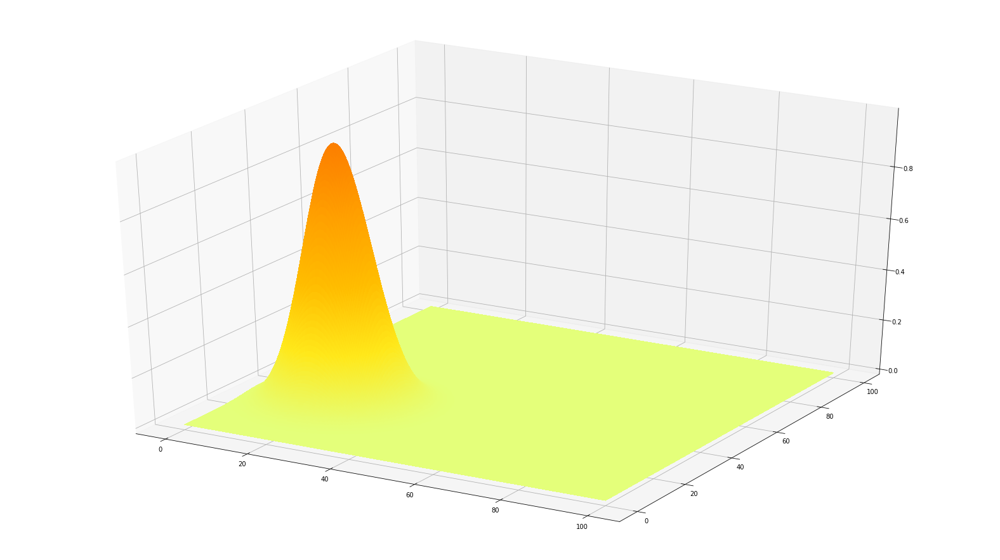

In [ ]:
#Gráfica en 3D del perfil gaussiano inicial
x_0 = 20.
y_0 = 30.
sigma = np.sqrt(50.) 
n = 300
x_interval = np.linspace(0,100,n)
y_interval = np.linspace(0,100,n)

def perfil(x, x_0, y, y_0, sigma):
    g = np.exp(-((x-x_0)**2 + (y-y_0)**2)/(2*(sigma**2)))
    return g

X = x_interval
Y = y_interval
X, Y = np.meshgrid(X, Y)
Z = perfil(X, x_0, Y, y_0, sigma)

                                        
fig = plt.figure(figsize = (28,16))
ax = fig.add_subplot(1,1,1, projection='3d')
surface = ax.plot_surface(X, Y, Z, rstride=1, cstride=1, cmap=cm.Wistia, linewidth=0, antialiased=False)
plt.show()

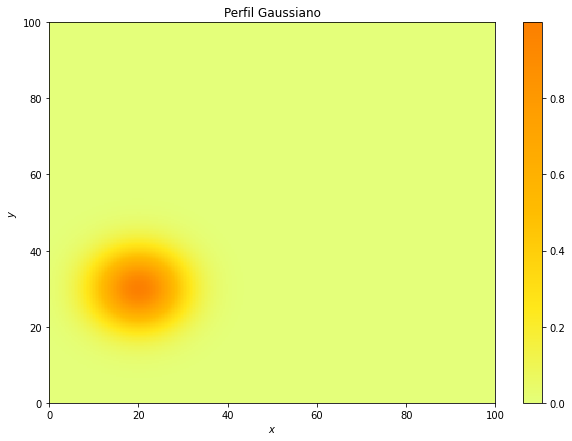

In [ ]:
#El mismo perfil en dos dimensiones se ve como
z_interval = np.zeros([n,n])

for i in range(n):
    z_interval[i,:] = perfil(x_interval[i], x_0, y_interval, y_0, sigma) 

plt.figure(figsize=(10,7))
plt.pcolormesh(x_interval, y_interval, z_interval.T, shading='auto',cmap = 'Wistia') 
plt.title("Perfil Gaussiano")
plt.xlabel('$x$')
plt.ylabel('$y$')
plt.colorbar()
plt.show()

In [ ]:
#Definición del método de volúmenes finitos y la condición de frontera de gradiente nulo
def der(a, ds):
    dads = np.zeros(len(a))
    dads[0] = (a[1] - a[0])/(2*ds)
    dads[-1] = (a[-1] - a[-2])/(2*ds)
    for i in range(1,len(a)-1):
        dads[i] = (a[i+1] - a[i-1])/(2*ds)
    return dads

def F(a,vel):
    return vel*a 

def Riemann(a,v,ds,dt):
    dads = der(a,ds)
    a_halftime = np.zeros(len(a))
    if v>0:
        for i in range(len(a)):
            a_halftime[i] = a[i] + (ds/2.)*(1-(dt/ds)*v)*dads[i]
    else:
        for i in range(len(a)-2, -1, -1):
            a_halftime[i] = a[i+1] - (ds/2.)*(1+(dt/ds)*v)*dads[i+1]
    return a_halftime

def VolF(a,v,ds,dt):
    anew = np.zeros(len(a)) 
    Ra = Riemann(a,v,ds,dt)
    Fa = F(Ra,v)
    for j in range(1,len(a)):
        anew[j] = a[j] - (dt/ds)*(Fa[j] - Fa[j-1])
        
    #Y la condición del gradiente nulo 
    if v>0:
        anew[0] = a[0]
    else:
        anew[-1] = a[-1]
    return anew

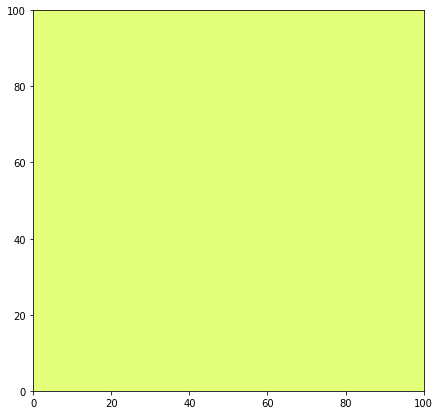

In [ ]:
#Valores iniciales para las velocidades
vx = 0.8
vy = 1.0

#Coeficiente CFL o número de Courant-Friedrichs-Levy
C = 0.5

# Paso temporal
t_i = 0.
t_f = 200.
dx = x_interval[1] - x_interval[0]
dy = y_interval[1] - y_interval[0]

dt = C*dx/abs(vx)
tgrid = np.arange(t_i, t_f, dt)

#Animación (Con las condiciones en este momento se demora 9min :v)
fig = plt.figure(figsize=(7,7))
ims = []

zstar = np.zeros([n,n])
znew = np.zeros([n,n])
for k in range(1,len(tgrid)):
    for j in range(len(y_interval)):
        zstar[:,j] = VolF(z_interval[:,j],vx,dx,dt)
    for i in range(len(x_interval)):
        znew[i,:] = VolF(zstar[i,:],vy,dy,dt)
    z_interval = znew
    im = plt.pcolormesh(x_interval, y_interval, z_interval[1:,1:].T,shading='auto',cmap = 'Wistia')
    ims.append([im])


ani = animation.ArtistAnimation(fig, ims, interval=50, blit=True,
                                repeat_delay=1000)


HTML(ani.to_jshtml())